In [519]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.decomposition import PCA


from scipy import stats


def human_format(num):
    num = float('{:.3g}'.format(num))
    magnitude = 0
    while abs(num) >= 1000:
        magnitude += 1
        num /= 1000.0
    return '{}{}'.format('{:f}'.format(num).rstrip('0').rstrip('.'), ['', 'K', 'M', 'B', 'T'][magnitude])

wd ='xx'

sns.set()
sns.set_style("whitegrid") #for whitebackground charts


In [520]:
df =  pd.read_csv('vehicle_reduced.csv'
                     ,sep=','
                     #,parse_dates=['ORDER_DT','DDATE']
                     #,usecols=['AUTO_RENEW','CHANGE_DT']
                     #,na_values = 0 cant use zero here
                     #,index_col = ['SKU']
                     #,encoding = "ISO-8859-1"
                     #,dtype={'NEWSLETTER': str}
                     )

In [521]:
df.drop(['Unnamed: 0','county'],axis=1,inplace=True)#mistake on my export


In [522]:
df.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,state
0,7088746062,greensboro,10299,2012.0,acura,tl,NaN,NaN,gas,90186.0,clean,automatic,NaN,NaN,other,blue,nc
1,7088745301,greensboro,0,2011.0,bmw,335,NaN,6 cylinders,gas,115120.0,clean,automatic,rwd,NaN,convertible,blue,nc
2,7088744126,greensboro,9500,2011.0,jaguar,xf,excellent,NaN,gas,85000.0,clean,automatic,NaN,NaN,NaN,blue,nc
3,7088743681,greensboro,3995,2004.0,honda,element,NaN,NaN,gas,212526.0,clean,automatic,fwd,NaN,SUV,orange,nc
4,7074612539,lincoln,41988,2016.0,chevrolet,silverado k2500hd,NaN,NaN,gas,NaN,clean,automatic,NaN,NaN,NaN,NaN,ne


In [523]:
for y in df.columns:
    if(df[y].dtype == np.float64 or df[y].dtype == np.int64):
          df[y] = df[y].fillna(0)
    if(df[y].dtype == np.object):
           df[y] = df[y].fillna('Missing') 
    else:
        df[y] =df[y]  #this does not clean booleans or dates   

In [524]:
df.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,state
0,7088746062,greensboro,10299,2012.0,acura,tl,Missing,Missing,gas,90186.0,clean,automatic,Missing,Missing,other,blue,nc
1,7088745301,greensboro,0,2011.0,bmw,335,Missing,6 cylinders,gas,115120.0,clean,automatic,rwd,Missing,convertible,blue,nc
2,7088744126,greensboro,9500,2011.0,jaguar,xf,excellent,Missing,gas,85000.0,clean,automatic,Missing,Missing,Missing,blue,nc
3,7088743681,greensboro,3995,2004.0,honda,element,Missing,Missing,gas,212526.0,clean,automatic,fwd,Missing,SUV,orange,nc
4,7074612539,lincoln,41988,2016.0,chevrolet,silverado k2500hd,Missing,Missing,gas,0.0,clean,automatic,Missing,Missing,Missing,Missing,ne


In [525]:
display(df.shape)
display(sum(df['price']<=1))
display(sum(df['odometer']<=1))
display(    sum( (df['odometer']<=1) | (df['price']<=1))) #or 

(539759, 17)

47631

101925

137315

In [526]:
#drop anything with no price and no mileage
df.drop(df[df['price']<=1].index, inplace=True)
df.drop(df[df['odometer']<=1].index, inplace=True)
display(df.shape)


(402444, 17)

In [527]:
df.describe()


,id,price,year,odometer
count,4.024440e+05,4.024440e+05,402444.000000,4.024440e+05
mean,7.087673e+09,1.612619e+05,2006.042948,1.033948e+05
std,5.195343e+06,2.064563e+07,95.605839,1.831549e+05
min,7.065765e+09,2.000000e+00,0.000000,2.000000e+00
25%,7.084369e+09,6.000000e+03,2007.000000,4.961750e+04
50%,7.089006e+09,1.199500e+04,2012.000000,9.600000e+04
75%,7.092105e+09,1.990000e+04,2015.000000,1.400000e+05
max,7.093537e+09,4.198287e+09,2021.000000,6.480922e+07


In [528]:
df['odometer'].max()

64809218.0

In [529]:
df['price'].max()

4198286601

In [530]:
#remove any obvious errounous data 
df.drop(df[df['odometer']>=1000000].index, inplace=True) #maybe some legitamate but its fine
df.drop(df[df['price']>=100000].index, inplace=True) # secound hand cars
display(df.shape)



(401634, 17)

In [531]:
from scipy.stats import zscore

#collist = df.select_dtypes(include=[np.number]).columns
collist=['price','odometer'] #override

for x in collist:
    df[x+'_z'] = zscore(df[x])
    df[x+'_z_abs'] = np.floor(np.abs(zscore(df[x])))
    
#df[numeric_cols].apply(zscore)

df.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,...,transmission,drive,size,type,paint_color,state,price_z,price_z_abs,odometer_z,odometer_z_abs
0,7088746062,greensboro,10299,2012.0,acura,tl,Missing,Missing,gas,90186.0,...,automatic,Missing,Missing,other,blue,nc,-0.381368,0.0,-0.160713,0.0
2,7088744126,greensboro,9500,2011.0,jaguar,xf,excellent,Missing,gas,85000.0,...,automatic,Missing,Missing,Missing,blue,nc,-0.453386,0.0,-0.238886,0.0
3,7088743681,greensboro,3995,2004.0,honda,element,Missing,Missing,gas,212526.0,...,automatic,fwd,Missing,SUV,orange,nc,-0.949587,0.0,1.683416,1.0
5,7088741557,greensboro,12995,2015.0,kia,sportage,Missing,Missing,gas,85127.0,...,automatic,4wd,Missing,wagon,Missing,nc,-0.138360,0.0,-0.236971,0.0
6,7088741418,greensboro,10995,2014.0,chevrolet,traverse,Missing,Missing,gas,112383.0,...,automatic,fwd,Missing,SUV,black,nc,-0.318633,0.0,0.173880,0.0


In [532]:
df[df['odometer_z']>=5]

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,...,transmission,drive,size,type,paint_color,state,price_z,price_z_abs,odometer_z,odometer_z_abs
352,7082678125,richmond,21999,2012.0,Missing,peterbilt 386,good,6 cylinders,diesel,594000.0,...,manual,rwd,Missing,truck,red,va,0.673228,0.0,7.433679,7.0
1067,7087037363,greensboro,16,1995.0,Missing,Freightliner Classic,good,Missing,diesel,900000.0,...,automatic,Missing,Missing,Missing,Missing,nc,-1.308240,1.0,12.046262,12.0
5666,7087929243,rockford,27000,2009.0,Missing,384,good,Missing,diesel,798000.0,...,manual,Missing,Missing,Missing,white,il,1.124000,1.0,10.508735,10.0
6833,7079601601,western massachusetts,7200,2007.0,gmc,canyon,excellent,5 cylinders,gas,925665.0,...,automatic,4wd,full-size,pickup,grey,ma,-0.660700,0.0,12.433132,12.0
7501,7077664080,western massachusetts,6995,2001.0,ford,mustang cobra,good,8 cylinders,gas,999999.0,...,manual,rwd,compact,coupe,black,ma,-0.679178,0.0,13.553628,13.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
536929,7089298248,la salle co,12000,2009.0,Missing,International transtar,Missing,Missing,diesel,450000.0,...,manual,Missing,Missing,Missing,Missing,il,-0.228046,0.0,5.263052,5.0
537836,7091532066,nashville,46500,1948.0,mercury,convertible,Missing,8 cylinders,gas,999999.0,...,manual,Missing,Missing,Missing,Missing,tn,2.881660,2.0,13.553628,13.0
537949,7091519380,nashville,42500,1966.0,chevrolet,impala,Missing,8 cylinders,gas,999999.0,...,manual,Missing,Missing,Missing,Missing,tn,2.521114,2.0,13.553628,13.0
538107,7077394346,syracuse,12995,2012.0,bmw,x5,Missing,6 cylinders,gas,945000.0,...,automatic,4wd,Missing,SUV,grey,ny,-0.138360,0.0,12.724584,12.0


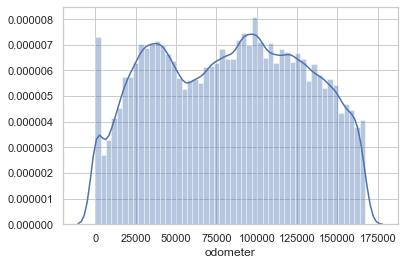

In [533]:
sns.distplot(df[df['odometer_z']<=1]['odometer'])

In [534]:
df['odometer'].min()

2.0

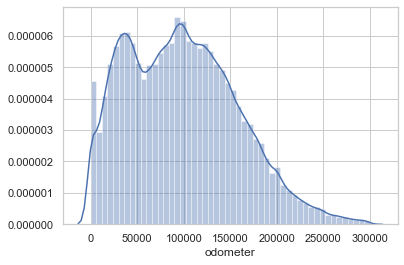

In [535]:
sns.distplot(df[df['odometer_z']<=3]['odometer'])

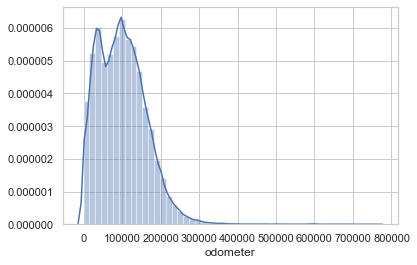

In [536]:
sns.distplot(df[df['odometer_z']<=10]['odometer'])

In [537]:
df.groupby('odometer_z_abs').agg({'odometer':[np.min,np.count_nonzero]})

odometer              
                    amin count_nonzero
odometer_z_abs                        
0.0              34508.0      281358.0
1.0                  2.0      110154.0
2.0             233532.0        7624.0
3.0             299898.0        1369.0
4.0             366378.0         301.0
5.0             433120.0         177.0
6.0             499103.0         128.0
7.0             565695.0         168.0
8.0             632222.0          91.0
9.0             700000.0          54.0
10.0            765000.0          58.0
11.0            831000.0          40.0
12.0            897120.0          56.0
13.0            964236.0          56.0

In [538]:
df.groupby('price_z_abs').agg({'price':[np.min,np.count_nonzero]})

price              
              amin count_nonzero
price_z_abs                     
0.0           3440        308588
1.0              2         75399
2.0          36722         11680
3.0          47826          3670
4.0          58921          1531
5.0          70265           404
6.0          81500           228
7.0          92497           134

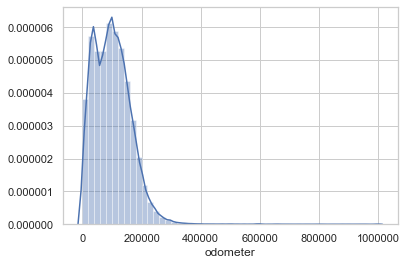

In [539]:
sns.distplot(df[df['price_z_abs']<=3]['odometer'])

In [540]:
#going to drop anything outside of 3rd dog for my range
display(df.shape)

df.drop(df[df['price_z_abs']>=3].index, inplace=True)
df.drop(df[df['odometer_z_abs']>=3].index, inplace=True)
display(df.shape)


(401634, 21)

(393279, 21)

In [541]:
df.groupby(['year']).size()

year
0.0         757
1908.0        3
1912.0        4
1914.0        1
1918.0        4
          ...  
2017.0    32002
2018.0    18757
2019.0    11054
2020.0     1159
2021.0        8
Length: 101, dtype: int64

In [542]:
df.drop(df[df['year']==0].index, inplace=True)


In [543]:
df.groupby(['year']).size()

year
1908.0        3
1912.0        4
1914.0        1
1918.0        4
1922.0        1
          ...  
2017.0    32002
2018.0    18757
2019.0    11054
2020.0     1159
2021.0        8
Length: 100, dtype: int64

In [544]:
df.drop(df[df['year']<=1990].index, inplace=True)


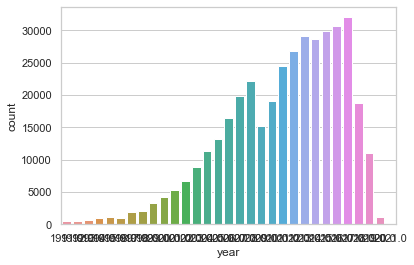

In [545]:
sns.countplot(x="year", data=df)

In [546]:
df.drop(df[df['year']<=2000].index, inplace=True)


In [547]:
df.drop(df[df['year']>=2020].index, inplace=True)


In [548]:
df['year'] = df['year'].astype(int)

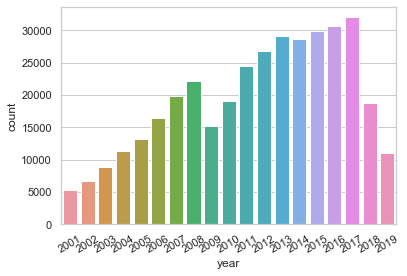

In [549]:
ax =sns.countplot(x="year", data=df)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30)
plt.show()

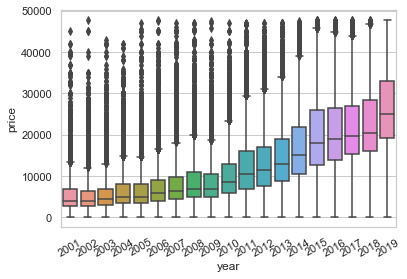

In [550]:
#fig = plt.figure()
ax = sns.boxplot(x="year", y="price", data=df)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30)
plt.show()

In [551]:
df.head().T

,0,2,3,5,6
id,7088746062,7088744126,7088743681,7088741557,7088741418
region,greensboro,greensboro,greensboro,greensboro,greensboro
price,10299,9500,3995,12995,10995
year,2012,2011,2004,2015,2014
manufacturer,acura,jaguar,honda,kia,chevrolet
model,tl,xf,element,sportage,traverse
condition,Missing,excellent,Missing,Missing,Missing
cylinders,Missing,Missing,Missing,Missing,Missing
fuel,gas,gas,gas,gas,gas
odometer,90186,85000,212526,85127,112383


In [552]:
df.groupby('transmission').size()
df.drop(df[df['transmission']=='Missing'].index, inplace=True)


In [553]:
df.groupby('size').size()
df.drop(['size'],axis=1,inplace=True)


In [554]:
df.groupby('type').size()
df.drop(df[df['type']=='Missing'].index, inplace=True)


In [555]:
df.groupby('type').size()


type
SUV            74616
bus              322
convertible     5561
coupe          15150
hatchback      12352
mini-van        5411
offroad          384
other          13883
pickup         43389
sedan          75409
truck          34657
van             8217
wagon           9819
dtype: int64

In [556]:
df['title_status'] = df['title_status'].str.strip()
df.groupby('title_status').size()
df.drop(df[df['title_status']!='clean'].index, inplace=True)


In [557]:
df.groupby('drive').size()
df.drop(df[df['drive']=='Missing'].index, inplace=True)


In [592]:
df.groupby('drive').size()


drive
4wd    108467
fwd     84315
rwd     39769
dtype: int64

In [558]:
display(df.groupby('fuel').size())
df.drop(df[df['fuel']=='Missing'].index, inplace=True)


fuel
Missing       1440
diesel       18827
electric       498
gas         213724
hybrid        2506
other         7149
dtype: int64

In [559]:
df.drop(df[df['fuel'].isin(['electric','hybrid','other'])].index, inplace=True)
display(df.groupby('fuel').size())


fuel
diesel     18827
gas       213724
dtype: int64

In [560]:
display(df.groupby('condition').size())
#too many missing
df.drop(['condition'],axis=1,inplace=True)



condition
Missing      72981
excellent    78137
fair          2644
good         63704
like new     14678
new            321
salvage         86
dtype: int64

In [561]:
display(df.groupby('cylinders').size())
#may be able to fill this in using other models, leave for the moment

cylinders
10 cylinders      940
12 cylinders       42
3 cylinders       287
4 cylinders     53939
5 cylinders      1744
6 cylinders     65117
8 cylinders     50365
Missing         59898
other             219
dtype: int64

In [562]:
display(df.groupby('state').size())


state
ak     2330
al     3587
ar     1859
az     3871
ca    22325
co     6444
ct     3403
dc     1251
de      705
fl    17065
ga     3260
hi     1335
ia     5482
id     5314
il     4815
in     3586
ks     3142
ky     2702
la     2071
ma     5202
md     2317
me     1272
mi     8389
mn     4149
mo     2784
ms      914
mt     5068
nc     7250
nd      441
ne      823
nh     1507
nj     4236
nm     1497
nv     1470
ny    10471
oh     9162
ok     2897
or     9148
pa     9025
ri     1468
sc     3491
sd      745
tn     7208
tx    11269
ut      537
va     5789
vt     1771
wa     9178
wi     7332
wv      566
wy      628
dtype: int64

In [563]:
df.head().T

,3,5,6,8,10
id,7088743681,7088741557,7088741418,7088737004,7088732376
region,greensboro,greensboro,greensboro,greensboro,greensboro
price,3995,12995,10995,3995,7995
year,2004,2015,2014,2007,2008
manufacturer,honda,kia,chevrolet,toyota,nissan
model,element,sportage,traverse,solara,frontier
cylinders,Missing,Missing,Missing,Missing,Missing
fuel,gas,gas,gas,gas,gas
odometer,212526,85127,112383,185123,162214
title_status,clean,clean,clean,clean,clean


In [564]:
#good variables, price, year, fuel, odo, trans, drive, type, state

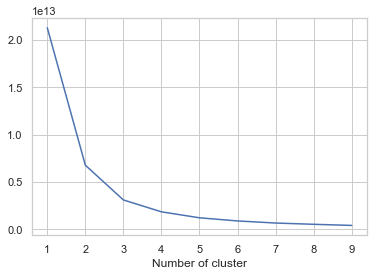

In [565]:
#using example from RFM for single variable 

#from sklearn.cluster import KMeans


sse={}
tt = df[['price']].copy()
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(tt)
    tt["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()



In [566]:
kmeans = KMeans(n_clusters=3) 
kmeans.fit(df[['price']])
df['priceCluster'] = kmeans.predict(df[['price']])

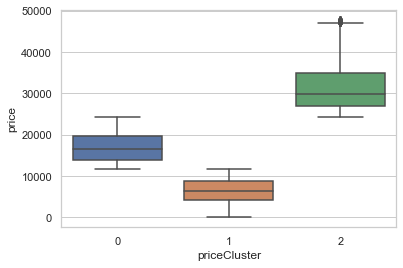

In [567]:
#fig = plt.figure()
ax = sns.boxplot(x="priceCluster", y="price", data=df)
plt.show()

In [568]:
#try a multidimentional example 

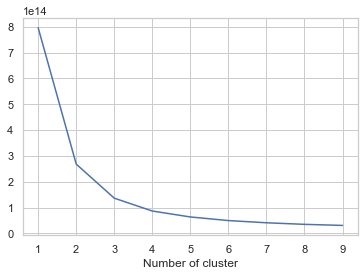

In [569]:

sse={}
tt = df[['price','year', 'odometer']].copy()
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(tt)
    tt["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

In [570]:
tt = df[['price','year', 'odometer']].copy()
kmeans = KMeans(n_clusters=3) 

df['priceYearOdo_cluster_FP'] = kmeans.fit_predict(tt)


In [571]:
tt = df[['price','year', 'odometer']].copy()
kmeans = KMeans(n_clusters=3) 
kmeans.fit(tt)
df['priceYearOdo_cluster'] = kmeans.predict(tt)


In [572]:
pd.pivot_table(data= df
              ,values='id'
              ,index='priceYearOdo_cluster'
              ,columns='priceYearOdo_cluster_FP'
              ,aggfunc=np.count_nonzero
              ,fill_value=0)

priceYearOdo_cluster_FP,0,1,2
priceYearOdo_cluster,,,
0,96876,0,0
1,0,86551,0
2,0,0,49124


In [573]:
tt = df[['price','year', 'odometer']].copy()
kmeans = KMeans(n_clusters=3) 

df['priceYearOdo_cluster_FP'] = kmeans.fit_predict(tt)

In [574]:
tt = df[['price','year', 'odometer']].copy()
kmeans = KMeans(n_clusters=3) 
kmeans.fit(tt)
df['priceYearOdo_cluster'] = kmeans.predict(tt)

In [575]:
pd.pivot_table(data= df
              ,values='id'
              ,index='priceYearOdo_cluster'
              ,columns='priceYearOdo_cluster_FP'
              ,aggfunc=np.count_nonzero
              ,fill_value=0)
#the above methods are equivilant I think, clusting has an element of randomness in it?

priceYearOdo_cluster_FP,0,1,2
priceYearOdo_cluster,,,
0,7,96859,0
1,86544,0,0
2,0,17,49124


In [576]:
kmeans.cluster_centers_

array([[ 12197.2191894 ,   2010.50587409, 110097.6779572 ],
       [ 20504.83493173,   2015.11783171,  40556.07312255],
       [  8239.68943226,   2007.35902194, 183018.15961745]])

In [577]:
kmeans.cluster_centers_.shape

(3, 3)

In [578]:
kmeans.cluster_centers_[:, 0]

array([12197.2191894 , 20504.83493173,  8239.68943226])

In [579]:
kmeans.cluster_centers_[:, 2]

array([110097.6779572 ,  40556.07312255, 183018.15961745])

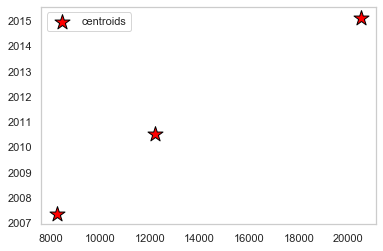

In [580]:
'''plt.scatter(
    X[y_km == 7, 0], X[y_km == 7, 1],
    s=50, c='mediumblue',
    marker='s', edgecolor='black',
    label='cluster 8'
)'''


# plot the centroids
plt.scatter(
    kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1],
    s=250, marker='*',
    c='red', edgecolor='black',
    label='centroids'
)
plt.legend(scatterpoints=1)
plt.grid()
plt.show()

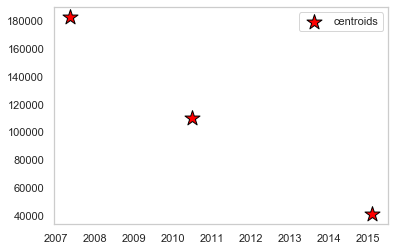

In [581]:
'''plt.scatter(
    X[y_km == 7, 0], X[y_km == 7, 1],
    s=50, c='mediumblue',
    marker='s', edgecolor='black',
    label='cluster 8'
)'''


# plot the centroids
plt.scatter(
    kmeans.cluster_centers_[:, 1], kmeans.cluster_centers_[:, 2],
    s=250, marker='*',
    c='red', edgecolor='black',
    label='centroids'
)
plt.legend(scatterpoints=1)
plt.grid()
plt.show()

#by changing the y value you get the cluster for the input variable 

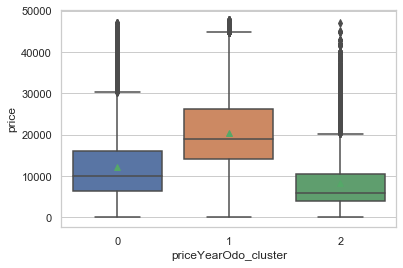

In [582]:
ax = sns.boxplot(x="priceYearOdo_cluster", y="price", data=df, showmeans=True )
plt.show()


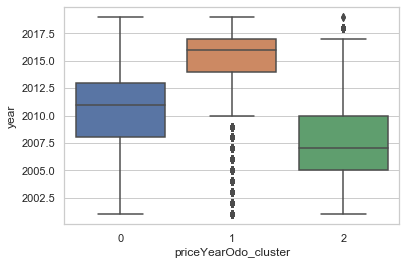

In [583]:
ax = sns.boxplot(x="priceYearOdo_cluster", y="year", data=df)
plt.show()


In [584]:
df.groupby('priceYearOdo_cluster').size()

priceYearOdo_cluster
0    96866
1    86544
2    49141
dtype: int64

In [585]:
import plotly.express as px

fig = px.parallel_coordinates(df, color="priceYearOdo_cluster",
                              dimensions=['year','price', 'odometer'])
                              #color_continuous_scale=px.colors.diverging.Tealrose,
                              #color_continuous_midpoint=2)
fig.show()



In [586]:
df.head().T

,3,5,6,8,10
id,7088743681,7088741557,7088741418,7088737004,7088732376
region,greensboro,greensboro,greensboro,greensboro,greensboro
price,3995,12995,10995,3995,7995
year,2004,2015,2014,2007,2008
manufacturer,honda,kia,chevrolet,toyota,nissan
model,element,sportage,traverse,solara,frontier
cylinders,Missing,Missing,Missing,Missing,Missing
fuel,gas,gas,gas,gas,gas
odometer,212526,85127,112383,185123,162214
title_status,clean,clean,clean,clean,clean


In [587]:
#for the catgorical I will need both onehotencode and standard scaler to make it work 

In [588]:
#try pd.get_dummies 

df_gd = pd.get_dummies(data = df, columns = ['fuel', 'transmission', 'drive', 'type'] )

df_gd.head().T





,3,5,6,8,10
id,7088743681,7088741557,7088741418,7088737004,7088732376
region,greensboro,greensboro,greensboro,greensboro,greensboro
price,3995,12995,10995,3995,7995
year,2004,2015,2014,2007,2008
manufacturer,honda,kia,chevrolet,toyota,nissan
model,element,sportage,traverse,solara,frontier
cylinders,Missing,Missing,Missing,Missing,Missing
odometer,212526,85127,112383,185123,162214
title_status,clean,clean,clean,clean,clean
paint_color,orange,Missing,black,black,red


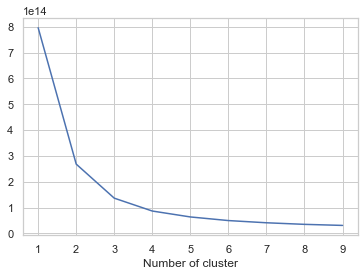

In [594]:
sse={}
tt = df_gd[['price','year', 'odometer']].copy()
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(tt)
    tt["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

In [597]:
df_gd.columns

Index(['id', 'region', 'price', 'year', 'manufacturer', 'model', 'cylinders',
       'odometer', 'title_status', 'paint_color', 'state', 'price_z',
       'price_z_abs', 'odometer_z', 'odometer_z_abs', 'priceCluster',
       'priceYearOdo_cluster_FP', 'priceYearOdo_cluster', 'fuel_diesel',
       'fuel_gas', 'transmission_automatic', 'transmission_manual',
       'transmission_other', 'drive_4wd', 'drive_fwd', 'drive_rwd', 'type_SUV',
       'type_bus', 'type_convertible', 'type_coupe', 'type_hatchback',
       'type_mini-van', 'type_offroad', 'type_other', 'type_pickup',
       'type_sedan', 'type_truck', 'type_van', 'type_wagon'],
      dtype='object')

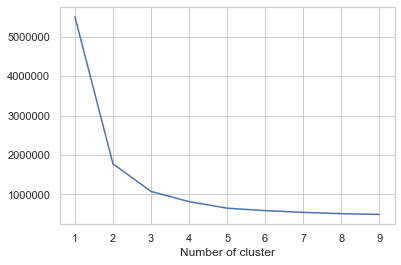

In [598]:


sse={}
tt = df_gd[['year', 'odometer', 'fuel_diesel',
       'fuel_gas', 'transmission_automatic', 'transmission_manual',
       'transmission_other', 'drive_4wd', 'drive_fwd', 'drive_rwd', 'type_SUV',
       'type_bus', 'type_convertible', 'type_coupe', 'type_hatchback',
       'type_mini-van', 'type_offroad', 'type_other', 'type_pickup',
       'type_sedan', 'type_truck', 'type_van', 'type_wagon']].copy()



for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(tt)
    tt["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

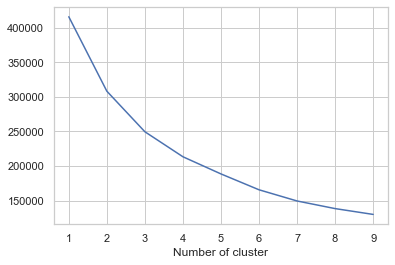

In [599]:
#from the one above this is a good example of what happens when unscaled data is put in ( i think!), year and odometer were really dominate
#above is correct 
sse={}
tt = df_gd[[ 'fuel_diesel',
       'fuel_gas', 'transmission_automatic', 'transmission_manual',
       'transmission_other', 'drive_4wd', 'drive_fwd', 'drive_rwd', 'type_SUV',
       'type_bus', 'type_convertible', 'type_coupe', 'type_hatchback',
       'type_mini-van', 'type_offroad', 'type_other', 'type_pickup',
       'type_sedan', 'type_truck', 'type_van', 'type_wagon']].copy()



for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(tt)
    tt["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

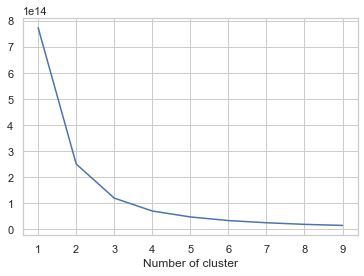

In [595]:
sse={}
tt = df_gd[['year', 'odometer','fuel_diesel','fuel_gas','drive_4wd','drive_fwd','drive_rwd']].copy()
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(tt)
    tt["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

In [600]:
tt = tt = df_gd[[ 'fuel_diesel',
       'fuel_gas', 'transmission_automatic', 'transmission_manual',
       'transmission_other', 'drive_4wd', 'drive_fwd', 'drive_rwd', 'type_SUV',
       'type_bus', 'type_convertible', 'type_coupe', 'type_hatchback',
       'type_mini-van', 'type_offroad', 'type_other', 'type_pickup',
       'type_sedan', 'type_truck', 'type_van', 'type_wagon']].copy()
kmeans = KMeans(n_clusters=8) 

df['cluster1'] = kmeans.fit_predict(tt)

display(df.groupby(['cluster1']).size())

cluster1
0    39369
1    14864
2    42216
3    17887
4    41329
5    25093
6    42836
7     8957
dtype: int64

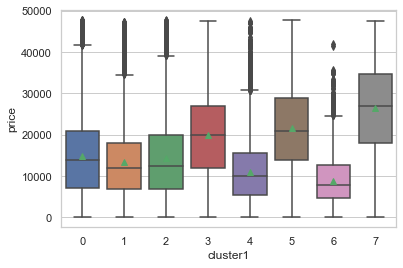

In [605]:
ax = sns.boxplot(x="cluster1", y="price", data=df, showmeans=True)
plt.show()


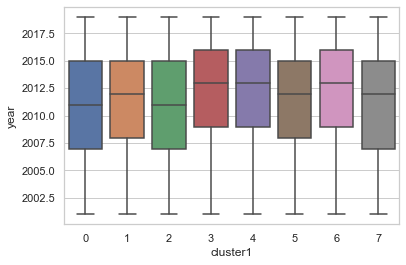

In [604]:
ax = sns.boxplot(x="cluster1", y="year", data=df)
plt.show()

# OHE junk below here ---------------------------------------------

In [ ]:
# Categorical boolean mask
categorical_feature_mask = df.dtypes==object
# filter categorical columns using mask and turn it into a list
categorical_cols = df.columns[categorical_feature_mask].tolist()

display(categorical_cols)
display(type(categorical_cols))

delcol = ['cylinders','paint_color','title_status','region']

for x in delcol:
    categorical_cols.remove(x)
    
display(categorical_cols)


In [466]:
#going to make it smaller still 
delcol = ['manufacturer','model','state']

for x in delcol:
    categorical_cols.remove(x)
    
display(categorical_cols)


['fuel', 'transmission', 'drive', 'type']

In [479]:
df.set_index('id',inplace=True)
df.head()


,region,price,year,manufacturer,model,cylinders,fuel,odometer,title_status,transmission,...,type,paint_color,state,price_z,price_z_abs,odometer_z,odometer_z_abs,priceCluster,priceYearOdo_cluster_FP,priceYearOdo_cluster
id,,,,,,,,,,,,,,,,,,,,,
7088743681,greensboro,3995,2004,honda,element,Missing,gas,212526.0,clean,automatic,...,SUV,orange,nc,-0.949587,0.0,1.683416,1.0,0,1,0
7088741557,greensboro,12995,2015,kia,sportage,Missing,gas,85127.0,clean,automatic,...,wagon,Missing,nc,-0.138360,0.0,-0.236971,0.0,1,2,2
7088741418,greensboro,10995,2014,chevrolet,traverse,Missing,gas,112383.0,clean,automatic,...,SUV,black,nc,-0.318633,0.0,0.173880,0.0,0,2,2
7088737004,greensboro,3995,2007,toyota,solara,Missing,gas,185123.0,clean,automatic,...,convertible,black,nc,-0.949587,0.0,1.270349,1.0,0,1,0
7088732376,greensboro,7995,2008,nissan,frontier,Missing,gas,162214.0,clean,automatic,...,pickup,red,nc,-0.589042,0.0,0.925023,0.0,0,1,0


In [480]:
#lets pretend we are clustering for price and trying to describe it 

# import labelencoder
from sklearn.preprocessing import LabelEncoder
# instantiate labelencoder object
le = LabelEncoder()



In [483]:
# apply le on categorical feature columns
#df[categorical_cols] = 
df1 = df[categorical_cols].apply(lambda col: le.fit_transform(col))

df1 = df1.add_suffix('_ohe')

#df1.head()


df = df.merge(df1, on='id')

In [484]:
df.head().T
#note this isn't one hot, its not a sparse matrix 

id,7088743681,7088741557,7088741418,7088737004,7088732376
region,greensboro,greensboro,greensboro,greensboro,greensboro
price,3995,12995,10995,3995,7995
year,2004,2015,2014,2007,2008
manufacturer,honda,kia,chevrolet,toyota,nissan
model,element,sportage,traverse,solara,frontier
cylinders,Missing,Missing,Missing,Missing,Missing
fuel,gas,gas,gas,gas,gas
odometer,212526,85127,112383,185123,162214
title_status,clean,clean,clean,clean,clean
transmission,automatic,automatic,automatic,automatic,automatic


In [489]:
categorical_feature_mask = df.dtypes==object
display(categorical_feature_mask)
type(categorical_feature_mask)

region                      True
price                      False
year                       False
manufacturer                True
model                       True
cylinders                   True
fuel                        True
odometer                   False
title_status                True
transmission                True
drive                       True
type                        True
paint_color                 True
state                       True
price_z                    False
price_z_abs                False
odometer_z                 False
odometer_z_abs             False
priceCluster               False
priceYearOdo_cluster_FP    False
priceYearOdo_cluster       False
fuel_ohe                   False
transmission_ohe           False
drive_ohe                  False
type_ohe                   False
dtype: bool

pandas.core.series.Series

In [499]:
cat_columns = ['fuel', 'transmission', 'drive', 'type']

df_processed =df[cat_columns].copy()

df_processed.head()


,fuel,transmission,drive,type
id,,,,
7088743681,gas,automatic,fwd,SUV
7088741557,gas,automatic,4wd,wagon
7088741418,gas,automatic,fwd,SUV
7088737004,gas,automatic,fwd,convertible
7088732376,gas,automatic,fwd,pickup


In [500]:
# For each categorical column
# We fit a label encoder, transform our column and 
# add it to our new dataframe
label_encoders = {}
for col in cat_columns:
    print("Encoding {}".format(col))
    new_le = LabelEncoder()
    df_processed[col] = new_le.fit_transform(df[col])
    label_encoders[col] = new_le

Encoding fuel
Encoding transmission
Encoding drive
Encoding type


In [501]:
df_processed.head()

,fuel,transmission,drive,type
id,,,,
7088743681,1,0,1,0
7088741557,1,0,0,12
7088741418,1,0,1,0
7088737004,1,0,1,2
7088732376,1,0,1,8


In [512]:
from sklearn.preprocessing import OneHotEncoder
onehotencoder = OneHotEncoder()
x = onehotencoder.fit_transform(df).toarray()


MemoryError: Unable to allocate 359. GiB for an array with shape (232551, 207102) and data type float64

In [502]:
#OHE does not support passing the list of categorical features by their names but only by their indexes

cat_columns_idx = [df_processed.columns.get_loc(col) 
                   for col in cat_columns]

display(cat_columns_idx)

[0, 1, 2, 3]

In [510]:
ohe = OneHotEncoder(handle_unknown='ignore')

df_processed_np = ohe.fit_transform(df_processed)

type(df_processed_np)

scipy.sparse.csr.csr_matrix

In [513]:
transformed = jobs_encoder.transform(df['fuel'].to_numpy().reshape(-1, 1))
#Create a Pandas DataFrame of the hot encoded column
ohe_df = pd.DataFrame(transformed, columns=jobs_encoder.get_feature_names())
#concat with original data
data = pd.concat([data, ohe_df], axis=1).drop(['Profession'], axis=1)

NameError: name 'jobs_encoder' is not defined